In [2]:
import cv2
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

# Load the trained model
model_best = load_model(r'C:\Users\dsilv\development\Emotion\face_model.h5') # set your machine model file path here

# Classes 7 emotional states
class_names = ['Angry', 'Disgusted', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']

# Load the pre-trained face cascade
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Open a connection to the webcam (0 is usually the default camera)
cap = cv2.VideoCapture(0)

while True:
    # Capture frame-by-frame
    ret, frame = cap.read()

    # Convert the frame to grayscale for face detection
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Detect faces in the frame
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=5, minSize=(30, 30))

    # Process each detected face
    for (x, y, w, h) in faces:
        # Extract the face region
        face_roi = frame[y:y + h, x:x + w]

        # Resize the face image to the required input size for the model
        face_image = cv2.resize(face_roi, (48, 48))
        face_image = cv2.cvtColor(face_image, cv2.COLOR_BGR2GRAY)
        face_image = image.img_to_array(face_image)
        face_image = np.expand_dims(face_image, axis=0)
        face_image = np.vstack([face_image])

        # Predict emotion using the loaded model
        predictions = model_best.predict(face_image)
        emotion_label = class_names[np.argmax(predictions)]

        # Display the emotion label on the frame
        cv2.putText(frame, f'Emotion: {emotion_label}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.9, (0, 0, 255), 2)

        # Draw a rectangle around the face
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)

    # Display the resulting frame
    cv2.imshow('Emotion Detection', frame)

    # Break the loop if 'q' key is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the webcam and close the window
cap.release()
cv2.destroyAllWindows()

C:\Users\dsilv\AppData\Roaming\Python\Python312\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━

KeyboardInterrupt: 

In [25]:
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import load_img, img_to_array

def predict_emotion(image_path, model_path=r'C:\Users\dsilv\development\Emotion\cnn_emotion_detection.h5'):
    # Load the saved model
    model = load_model(model_path)
    
    # Load and preprocess the image
    img = load_img(image_path, color_mode="grayscale", target_size=(48, 48))
    img_array = img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension

    # Predict the emotion
    predictions = model.predict(img_array)
    emotion_labels = ["Angry", "Disgust", "Fear", "Happy", "Sad", "Surprise", "Neutral"]
    predicted_emotion = emotion_labels[np.argmax(predictions)]
    
    return predicted_emotion

# Test the model with a user-provided image
image_path = r'C:\Users\dsilv\development\Emotion\Testing\1.jpg'
predicted_emotion = predict_emotion(image_path)
print(f"Predicted Emotion: {predicted_emotion}")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
Predicted Emotion: Surprise


https://www.kaggle.com/models/vinitvyas09/cnn_model_emotion_classification

In [47]:
import tensorflow as tf
from tensorflow.keras.models import load_model
import numpy as np
import cv2

# Load the model
model = load_model(r'C:\Users\dsilv\development\Emotion\cnn_emotion_detection.h5')

# Define the emotion labels
emotion_labels = ["Angry", "Disgust", "Fear", "Happy", "Sad", "Surprise", "Neutral"]

# Function to preprocess image
def preprocess_image(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    img = cv2.resize(img, (48, 48))
    img = img.astype('float32') / 255.0
    img = np.expand_dims(img, axis=0)
    img = np.expand_dims(img, axis=-1)
    return img

# Function to predict emotion
def predict_emotion(image_path):
    img = preprocess_image(image_path)
    prediction = model.predict(img)
    emotion_index = np.argmax(prediction)
    emotion = emotion_labels[emotion_index]  # Get the corresponding emotion label
    return emotion

# Example usage
image_path = r'C:\Users\dsilv\development\Emotion\Testing\7.jpg'
emotion = predict_emotion(image_path)
print(f'The predicted emotion is: {emotion}')


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step
The predicted emotion is: Angry


C:\Users\dsilv\AppData\Roaming\Python\Python312\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Found 7178 images belonging to 7 classes.


C:\Users\dsilv\AppData\Roaming\Python\Python312\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


225/225 ━━━━━━━━━━━━━━━━━━━━ 42s 188ms/step


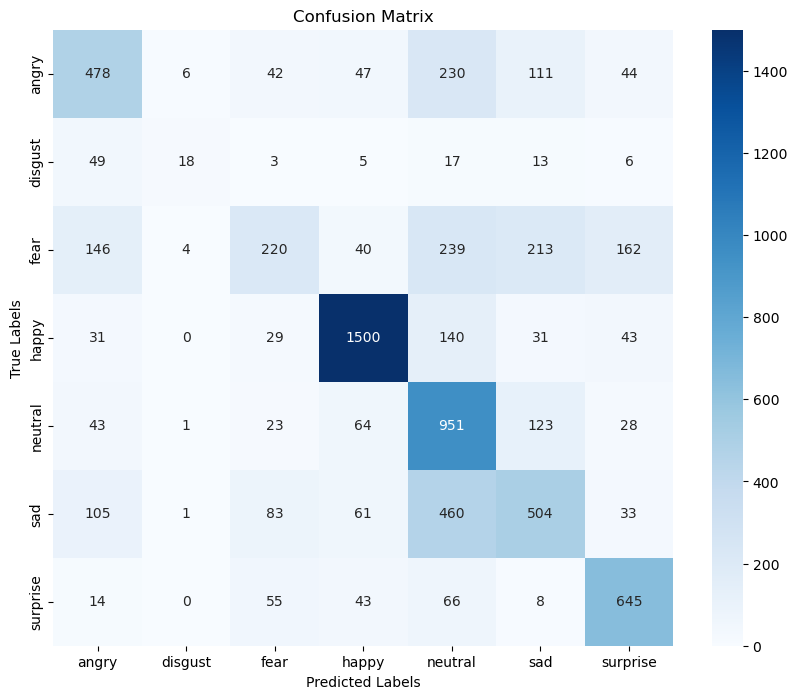

              precision    recall  f1-score   support

       angry       0.55      0.50      0.52       958
     disgust       0.60      0.16      0.26       111
        fear       0.48      0.21      0.30      1024
       happy       0.85      0.85      0.85      1774
     neutral       0.45      0.77      0.57      1233
         sad       0.50      0.40      0.45      1247
    surprise       0.67      0.78      0.72       831

    accuracy                           0.60      7178
   macro avg       0.59      0.52      0.52      7178
weighted avg       0.61      0.60      0.59      7178



In [2]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Paths
test_dir = r'C:\Users\dsilv\development\Emotion Detection\data\test'
model_path = r'C:\Users\dsilv\development\Emotion\backend\cnn_emotion_detection.h5'

# Load the pretrained model
model = load_model(model_path)

# Prepare the test data
test_datagen = ImageDataGenerator(rescale=1.0/255)  # Rescale pixel values to [0, 1]
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(48, 48),  # Set to the input size your model expects
    color_mode="grayscale",  # If your model uses grayscale images
    batch_size=32,
    class_mode='categorical',  # Assuming the model uses categorical output
    shuffle=False  # Ensure predictions match file order for confusion matrix
)

# Predict the test data
predictions = model.predict(test_generator)
predicted_classes = np.argmax(predictions, axis=1)

# True classes
true_classes = test_generator.classes
class_labels = list(test_generator.class_indices.keys())

# Generate the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.title('Confusion Matrix')
plt.ylabel('True Labels')
plt.xlabel('Predicted Labels')
plt.show()

# Classification report
print(classification_report(true_classes, predicted_classes, target_names=class_labels))


Music Recommendation

In [3]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

In [9]:
pip install yellowbrick

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [10]:
import yellowbrick

In [4]:
data = pd.read_csv(r"C:\Users\dsilv\development\Emotion\backend\data\data.csv")
genre_data = pd.read_csv(r'C:\Users\dsilv\development\Emotion\backend\data\data_by_genres.csv')
year_data = pd.read_csv(r'C:\Users\dsilv\development\Emotion\backend\data\data_by_year.csv')

In [5]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


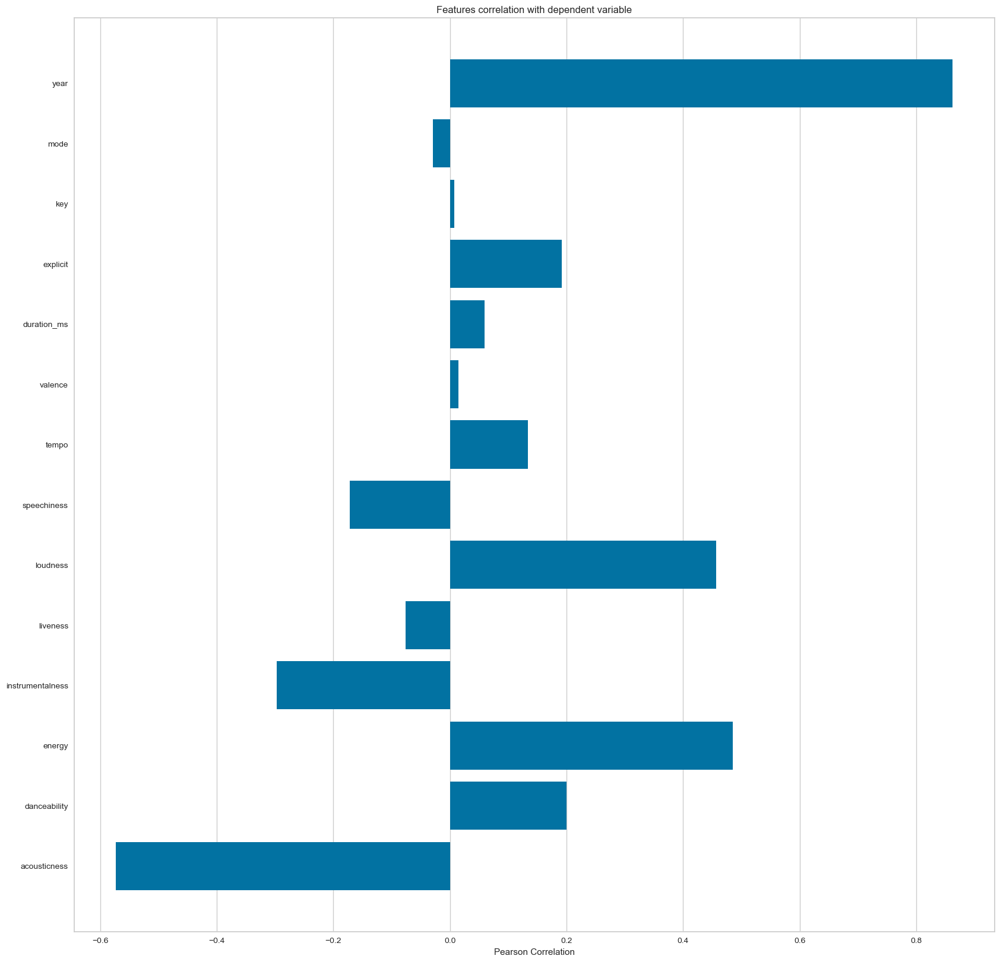

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [11]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

In [12]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(data['decade'])

<Axes: xlabel='count', ylabel='decade'>

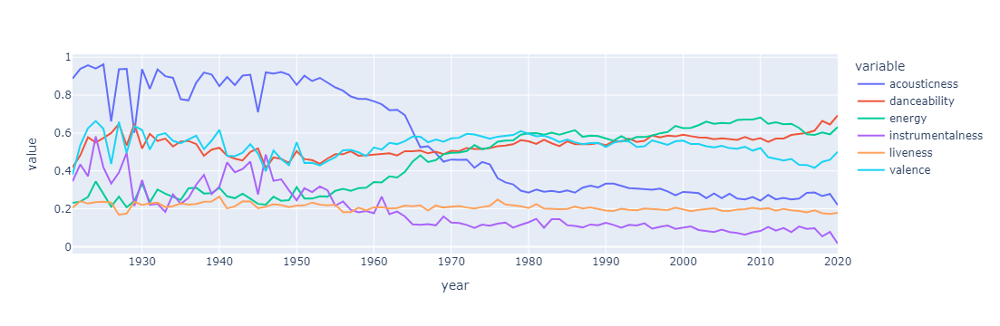

In [13]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

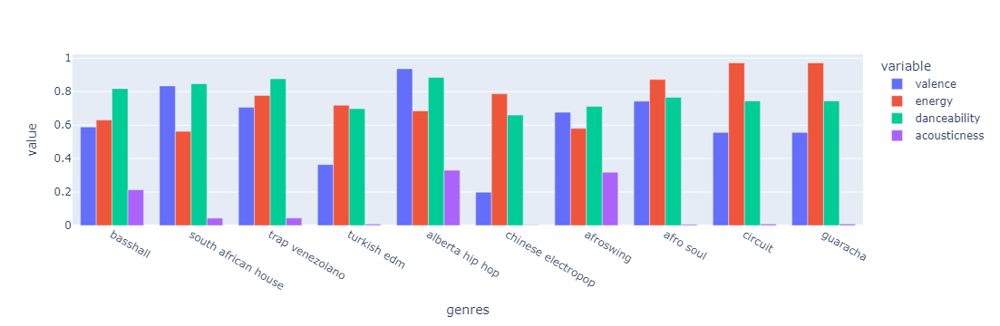

In [14]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

In [19]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.009s...
[t-SNE] Computed neighbors for 2973 samples in 0.329s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.102242
[t-SNE] KL divergence after 1000 iterations: 1.391682


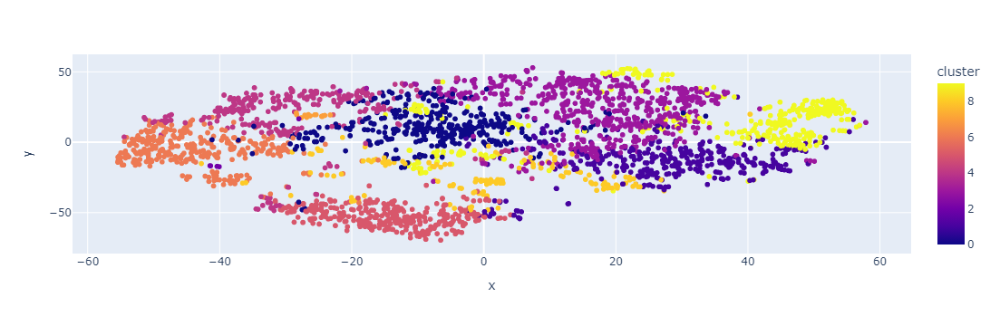

In [20]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

In [22]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

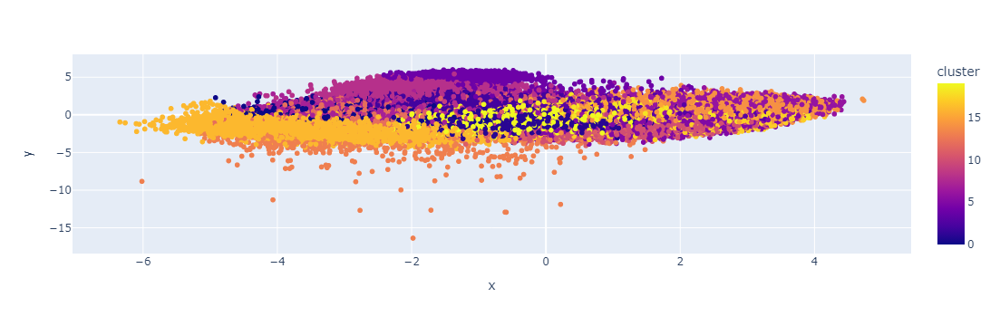

In [23]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

reccomedndation

In [25]:
!pip install spotipy

Defaulting to user installation because normal site-packages is not writeable


In [33]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
import pandas as pd

# Define client ID and secret
SPOTIFY_CLIENT_ID = "1f35b2325d49492394d29449ecad5656"
SPOTIFY_CLIENT_SECRET = "bf068d1d64b3493587d891f8320dfb2e"

# Initialize Spotipy with the client credentials
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(
    client_id=SPOTIFY_CLIENT_ID,
    client_secret=SPOTIFY_CLIENT_SECRET
))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q='track: {} year: {}'.format(name, year), limit=1)
    
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)


In [45]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def find_song(name):
    song_data = defaultdict()
    # Remove the 'year' from the query
    results = sp.search(q='track: {}'.format(name), limit=1)

    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']

    if not track_id:
        return None  # Ensure track_id is valid before making the request
    
    try:
        audio_features = sp.audio_features(track_id)[0]
    except spotipy.exceptions.SpotifyException as e:
        print(f"Error fetching audio features for {name}: {e}")
        return None

    song_data['name'] = [name]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

        

def get_mean_vector(song_list, spotify_data):
    song_vectors = []

    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs(song_list, spotify_data, n_songs=10):
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [49]:
recommend_songs([{'name': 'happy', 'year':1991}],  data)

TypeError: find_song() takes 1 positional argument but 2 were given

In [73]:
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity

# Emotion-to-feature mapping
emotion_to_features = {
    "Angry": {"valence": 0.2, "energy": 0.9, "tempo": 120},
    "Disgust": {"valence": 0.3, "energy": 0.5, "tempo": 80},
    "Fear": {"valence": 0.2, "energy": 0.8, "tempo": 140},
    "Happy": {"valence": 0.9, "energy": 0.8, "tempo": 140},
    "Sad": {"valence": 0.2, "energy": 0.3, "tempo": 60},
    "Surprise": {"valence": 0.8, "energy": 0.7, "tempo": 160},
    "Neutral": {"valence": 0.5, "energy": 0.5, "tempo": 100},
}

# Initialize an empty set to track previously recommended song indices
recommended_song_indices = set()

def recommend_songs(emotion, data, n_songs=4):
    global recommended_song_indices

    # Check if the emotion exists in the emotion_to_features dictionary
    if emotion not in emotion_to_features:
        print(f"Emotion '{emotion}' not recognized.")
        return []

    # Get the feature values for the emotion
    emotion_features = emotion_to_features[emotion]

    # Convert emotion features into a vector
    emotion_vector = np.array([
        emotion_features['valence'],
        emotion_features['energy'],
        emotion_features['tempo']
    ])

    # Check if the necessary columns exist in the data
    if not all(col in data.columns for col in ['valence', 'energy', 'tempo']):
        print("Data does not contain the required columns.")
        return []

    # Extract the song feature vectors (valence, energy, tempo) from the data
    song_features = data[['valence', 'energy', 'tempo']].values

    # Compute cosine similarity between the emotion vector and song features
    similarities = cosine_similarity([emotion_vector], song_features)[0]

    # Create a DataFrame with the song names and their similarity scores
    song_similarities = pd.DataFrame({
        'index': data.index,
        'name': data['name'],
        'similarity': similarities
    })

    # Remove already recommended songs
    song_similarities = song_similarities[~song_similarities['index'].isin(recommended_song_indices)]

    # Sort the songs by similarity in descending order
    song_similarities = song_similarities.sort_values(by='similarity', ascending=False)

    # Get the top n songs
    recommended_songs = song_similarities.head(n_songs)

    # Add the indices of recommended songs to the tracking set
    recommended_song_indices.update(recommended_songs['index'])

    # Return the recommended songs details
    recommended_songs_list = []
    for index, row in recommended_songs.iterrows():
        song_index = row['index']
        song_details = (
            f"Song: {data.loc[song_index, 'name']}\n"
            f"Artist(s): {data.loc[song_index, 'artists']}\n"
            f"Year: {data.loc[song_index, 'year']}\n"
            f"Valence: {data.loc[song_index, 'valence']:.2f}, Energy: {data.loc[song_index, 'energy']:.2f}, Tempo: {data.loc[song_index, 'tempo']} BPM\n"
            "-"*40
        )
        recommended_songs_list.append(song_details)

    return "\n".join(recommended_songs_list)

# Example usage
# Assuming 'data' is a DataFrame with your song dataset
# Example structure of 'data':
# data = pd.DataFrame({
#     'name': ['Song1', 'Song2', 'Song3', 'Song4', 'Song5'],
#     'artists': [['Artist1'], ['Artist2'], ['Artist3'], ['Artist4'], ['Artist5']],
#     'year': [2021, 2020, 2019, 2022, 2023],
#     'valence': [0.8, 0.7, 0.6, 0.5, 0.4],
#     'energy': [0.6, 0.7, 0.5, 0.8, 0.4],
#     'tempo': [120, 130, 110, 140, 100]
# })

# Test the function
emotion = "Happy"
print(recommend_songs(emotion, data))


Song: Romeo (with Billy Ray Cyrus, Tanya Tucker, Mary Chapin Carpenter, Kathy Mattea & Pam Tillis)
Artist(s): ['Dolly Parton', 'Billy Ray Cyrus', 'Tanya Tucker', 'Mary Chapin Carpenter', 'Kathy Mattea', 'Pam Tillis']
Year: 1993
Valence: 0.74, Energy: 0.66, Tempo: 115.862 BPM
-Song: Romeo (with Billy Ray Cyrus, Tanya Tucker, Mary Chapin Carpenter, Kathy Mattea & Pam Tillis)
Artist(s): ['Dolly Parton', 'Billy Ray Cyrus', 'Tanya Tucker', 'Mary Chapin Carpenter', 'Kathy Mattea', 'Pam Tillis']
Year: 1993
Valence: 0.74, Energy: 0.66, Tempo: 115.862 BPM
-Song: Romeo (with Billy Ray Cyrus, Tanya Tucker, Mary Chapin Carpenter, Kathy Mattea & Pam Tillis)
Artist(s): ['Dolly Parton', 'Billy Ray Cyrus', 'Tanya Tucker', 'Mary Chapin Carpenter', 'Kathy Mattea', 'Pam Tillis']
Year: 1993
Valence: 0.74, Energy: 0.66, Tempo: 115.862 BPM
-Song: Romeo (with Billy Ray Cyrus, Tanya Tucker, Mary Chapin Carpenter, Kathy Mattea & Pam Tillis)
Artist(s): ['Dolly Parton', 'Billy Ray Cyrus', 'Tanya Tucker', 'Mary C

In [1]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import MinMaxScaler

# Load datasets
data = pd.read_csv(r"C:\Users\dsilv\development\Emotion\backend\data\data.csv")

# Emotion-to-features mapping
emotion_to_features = {
    "Angry": {"valence": 0.2, "energy": 0.9, "tempo": 120},
    "Disgust": {"valence": 0.3, "energy": 0.5, "tempo": 80},
    "Fear": {"valence": 0.2, "energy": 0.8, "tempo": 140},
    "Happy": {"valence": 0.9, "energy": 0.8, "tempo": 140},
    "Sad": {"valence": 0.2, "energy": 0.3, "tempo": 60},
    "Surprise": {"valence": 0.8, "energy": 0.7, "tempo": 160},
    "Neutral": {"valence": 0.5, "energy": 0.5, "tempo": 100},
}

def recommend_songs(emotion, data, num_songs=4):
    # Get target features for the emotion
    target_features = emotion_to_features.get(emotion)
    if not target_features:
        return f"Emotion '{emotion}' is not recognized."
    
    # Normalize the features in the dataset
    scaler = MinMaxScaler()
    normalized_data = data[['valence', 'energy', 'tempo']].copy()
    normalized_data[['valence', 'energy', 'tempo']] = scaler.fit_transform(normalized_data)
    
    # Normalize the target emotion features
    target_vector = scaler.transform(
        np.array([[target_features['valence'], target_features['energy'], target_features['tempo']]])
    )
    
    # Calculate cosine similarity
    similarities = cosine_similarity(normalized_data, target_vector).flatten()
    data['similarity'] = similarities
    
    # Shuffle and select top matches
    top_matches = data.sort_values(by='similarity', ascending=False).head(20)
    recommended = top_matches.sample(n=min(num_songs, len(top_matches)), random_state=None)
    
    # Format the output
    formatted_recommendations = recommended[['name', 'artists', 'valence', 'energy', 'tempo']].reset_index(drop=True)
    return formatted_recommendations

# Example usage
emotion = "Sad"
top_songs = recommend_songs(emotion, data)

# Display the recommendations
print("Top Recommendations:")
print(top_songs.to_string(index=False))


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


Top Recommendations:
            name               artists  valence  energy   tempo
 Sweater Weather ['The Neighbourhood']    0.414   0.615 124.015
Who's Crying Now           ['Journey']    0.403   0.605 122.041
    Keep It Real              ['KYLE']    0.460   0.684 137.752
          Reggie            ['Junmai']    0.467   0.701 140.017
